# LIDAR Object detection Visualization
Visualize Kitti - LIDAR data

In [1]:
from viewer import *
from dataset import *
from box_operations import *
from base_operation import *

In [2]:
root = '../dataset/kitti/training/'
label_path = '../dataset/kitti/training/label_2'

dataset = KittiDetectionDataset(root, label_path)

vi = Viewer(box_type = "Kitti")
vi.set_ob_color_map('gnuplot')

def visualize_points(index):
    print(index)
    P2, V2C, points, image, labels, label_names = dataset[index]
    white_image = np.ones_like(image) * 255
    black_image = np.zeros_like(image)
    
    mask = label_names=="Car"
    labels = labels[mask]
    label_names = label_names[mask]
    ids = labels[:, -1].astype(int)
    
    vi.add_image(black_image)
    vi.set_extrinsic_mat(V2C)
    vi.set_intrinsic_mat(P2)
    vi.add_points(points[:,0:3], radius = 1000, color = (150,150,150),
                  scatter_filed = None, alpha=0, del_after_show = True,
                  add_to_3D_scene = True, add_to_2D_scene = True,
                  color_map_name = "cool")
    vi.save_2D(f"point_image_{index}.png")
    
def visualize_bev(index):
    P2, V2C, points, image, labels, label_names = dataset[index]
    white_image = np.ones_like(image) * 255
    black_image = np.zeros_like(image)
    
    mask = label_names=="Car"
    labels = labels[mask]
    label_names = label_names[mask]
    ids = labels[:, -1].astype(int)
    
    vi.add_image(black_image)
    vi.set_extrinsic_mat(V2C)
    vi.set_intrinsic_mat(P2)
    vi.add_points(points[:,0:3], radius = 1000, color = (150,150,150),
                  scatter_filed = None, alpha=0, del_after_show = True,
                  add_to_3D_scene = True, add_to_2D_scene = True,
                  color_map_name = "cool")
    vi.birds_eye_view(f"bev_image_{index}.png")
    

def visualize_bev_box(index):
    P2, V2C, points, image, labels, label_names = dataset[index]
    white_image = np.ones_like(image) * 255
    black_image = np.zeros_like(image)
    
    mask = label_names=="Car"
    labels = labels[mask]
    label_names = label_names[mask]
    ids = labels[:, -1].astype(int)
    
    vi.add_image(black_image)
    vi.set_extrinsic_mat(V2C)
    vi.set_intrinsic_mat(P2)
    vi.add_points(points[:,0:3], radius = 1000, color = (150,150,150),
                  scatter_filed = points[:,2], alpha=0, del_after_show = True,
                  add_to_3D_scene = True, add_to_2D_scene = True,
                  color_map_name = "cool")
    vi.add_3D_boxes(boxes=labels, ids=ids, box_info=label_names,
                 color="blue", add_to_3D_scene=True, add_to_2D_scene = True,
                 mesh_alpha = 0.3, show_corner_spheres = True, corner_spheres_alpha = 1,
                 corner_spheres_radius=0.1, show_heading = True, heading_scale = 1,
                 show_lines = True, line_width = 2, line_alpha = 1, show_ids = True,
                 show_box_info=True, del_after_show=True, caption_size=(0.05,0.05))
    
    vi.birds_eye_view(f"bev_image_{index}.png")
    
def visualize_image(index):
    P2, V2C, points, image, labels, label_names = dataset[index]
    white_image = np.ones_like(image) * 255
    black_image = np.zeros_like(image)
    
    mask = label_names=="Car"
    labels = labels[mask]
    label_names = label_names[mask]
    ids = labels[:, -1].astype(int)
    
    vi.add_image(image)
    vi.set_extrinsic_mat(V2C)
    vi.set_intrinsic_mat(P2)
    vi.save_2D(f"image_{index}.png")
    
def visualize_image_box(index):
    P2, V2C, points, image, labels, label_names = dataset[index]
    white_image = np.ones_like(image) * 255
    black_image = np.zeros_like(image)
    
    mask = label_names=="Car"
    labels = labels[mask]
    label_names = label_names[mask]
    ids = labels[:, -1].astype(int)
    
    vi.add_image(image)
    vi.set_extrinsic_mat(V2C)
    vi.set_intrinsic_mat(P2)
    vi.add_3D_boxes(boxes=labels, ids=ids, box_info=label_names,
                 color="blue", add_to_3D_scene=True, add_to_2D_scene = True,
                 mesh_alpha = 0.3, show_corner_spheres = True, corner_spheres_alpha = 1,
                 corner_spheres_radius=0.1, show_heading = True, heading_scale = 1,
                 show_lines = True, line_width = 2, line_alpha = 1, show_ids = True,
                 show_box_info=True, del_after_show=True, caption_size=(0.05,0.05))
    vi.save_2D(f"image_box_{index}.png")

def visualize(index):
    P2, V2C, points, image, labels, label_names = dataset[index]
    white_image = np.ones_like(image) * 255
    
    mask = label_names=="Car"
    labels = labels[mask]
    label_names = label_names[mask]
    ids = labels[:, -1].astype(int)
    
    vi.add_image(white_image)
    vi.set_extrinsic_mat(V2C)
    vi.set_intrinsic_mat(P2)
    vi.add_points(points[:,0:3], radius = 2, color = (150,150,150),
                  scatter_filed = None, alpha=0, del_after_show = True,
                  add_to_3D_scene = True, add_to_2D_scene = True,
                  color_map_name = "viridis")
    
    vi.add_3D_boxes(boxes=labels, ids=ids, box_info=label_names,
                 color="blue", add_to_3D_scene=True, add_to_2D_scene = True,
                 mesh_alpha = 0.3, show_corner_spheres = True, corner_spheres_alpha = 1,
                 corner_spheres_radius=0.1, show_heading = True, heading_scale = 1,
                 show_lines = True, line_width = 2, line_alpha = 1, show_ids = True,
                 show_box_info=True, del_after_show=True, caption_size=(0.05,0.05))
    
    vi.save_2D(f'image_full_{index}.png')

6747
Saving Image: point_image_6747.png
6029
Saving Image: point_image_6029.png
3509
Saving Image: point_image_3509.png
1658
Saving Image: point_image_1658.png
5832
Saving Image: point_image_5832.png


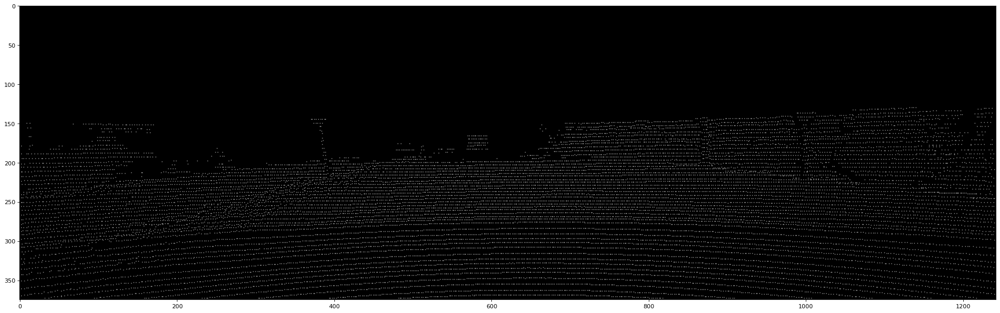

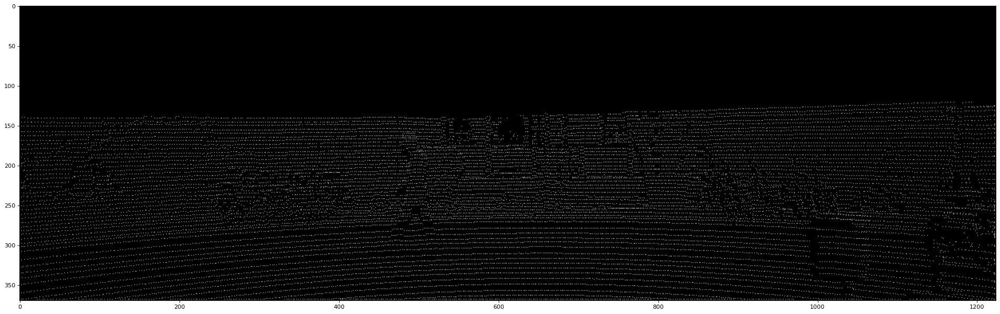

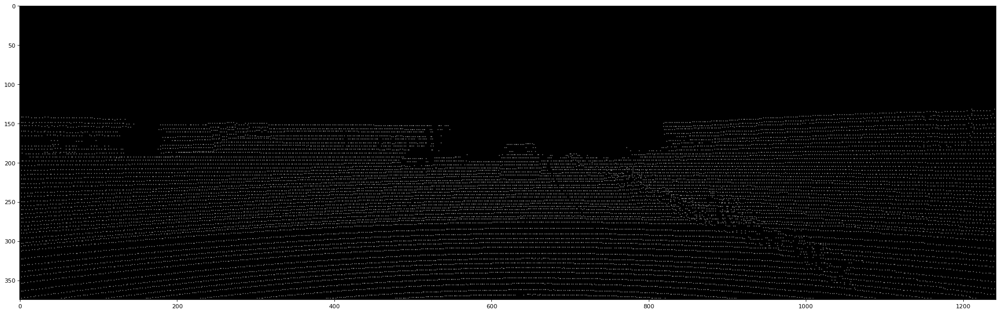

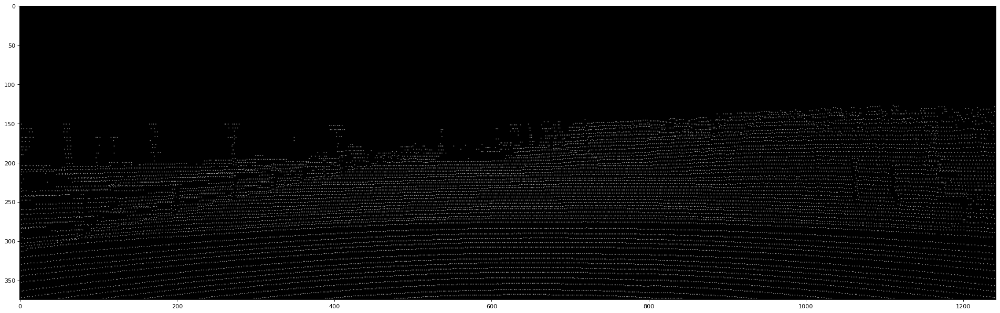

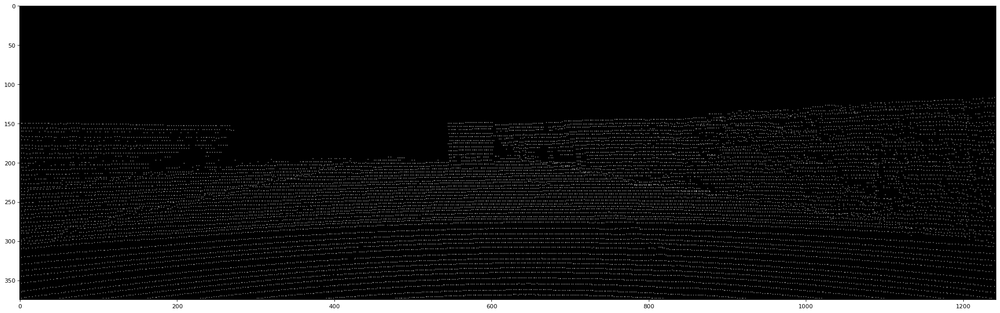

In [3]:
import random
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

index_list = random.sample(range(len(dataset)), 5)
images = []
for index in index_list:
    visualize_points(index)
    images.append(mpimg.imread(f"point_image_{index}.png"))
    
for image in images:
    plt.figure(figsize=(30, 30), dpi=80)
    plt.imshow(image)
    plt.show()

Saving Image: bev_image_6747.png
Saving Image: bev_image_6029.png
Saving Image: bev_image_3509.png
Saving Image: bev_image_1658.png
Saving Image: bev_image_5832.png


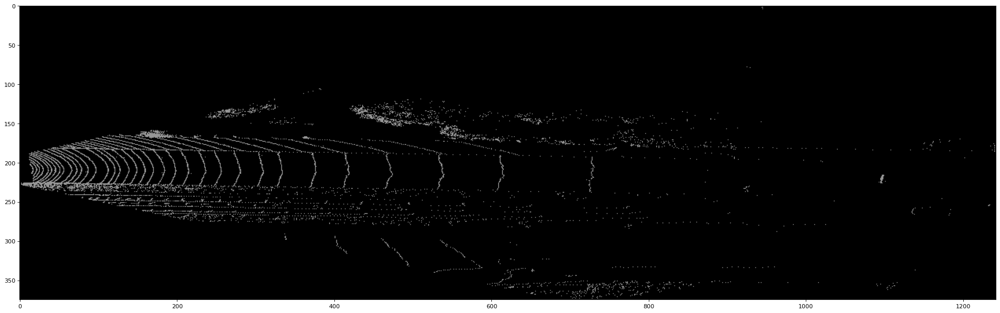

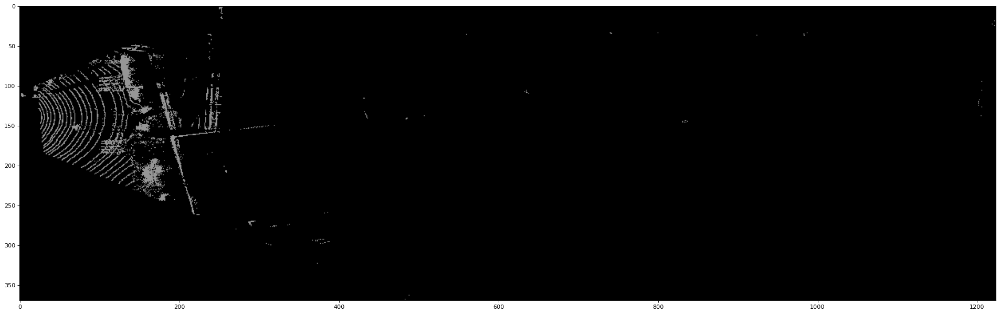

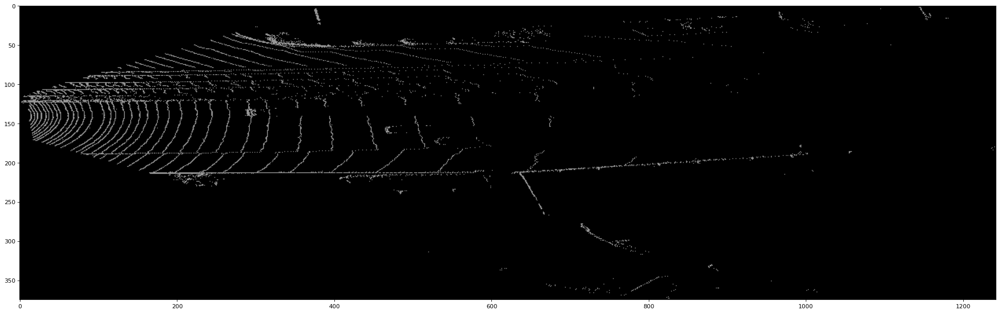

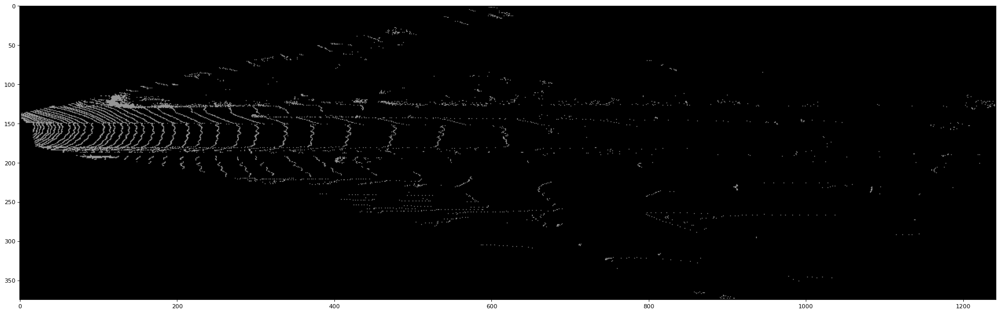

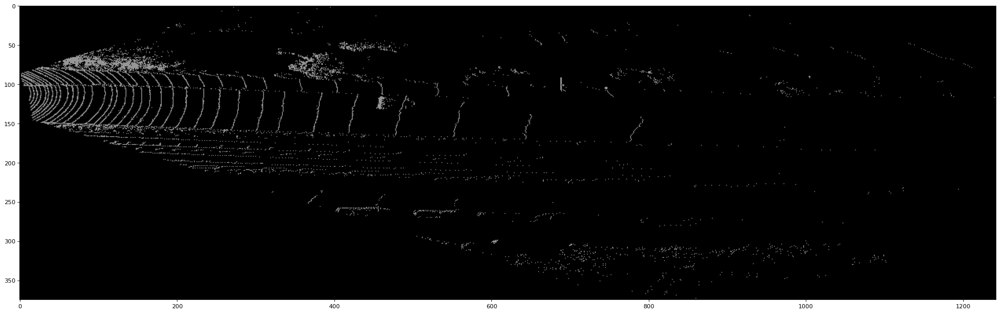

In [4]:
images = []
for index in index_list:
    visualize_bev(index)
    images.append(mpimg.imread(f"bev_image_{index}.png"))
    
for image in images:
    plt.figure(figsize=(30, 30), dpi=80)
    plt.imshow(image)
    plt.show()

Saving Image: image_6747.png
Saving Image: image_6029.png
Saving Image: image_3509.png
Saving Image: image_1658.png
Saving Image: image_5832.png


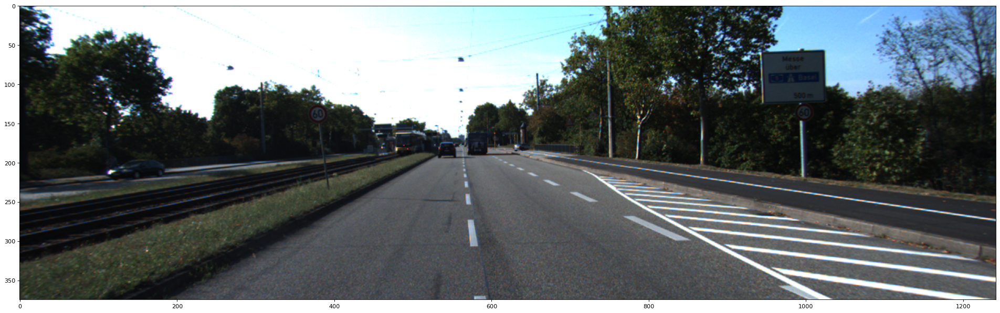

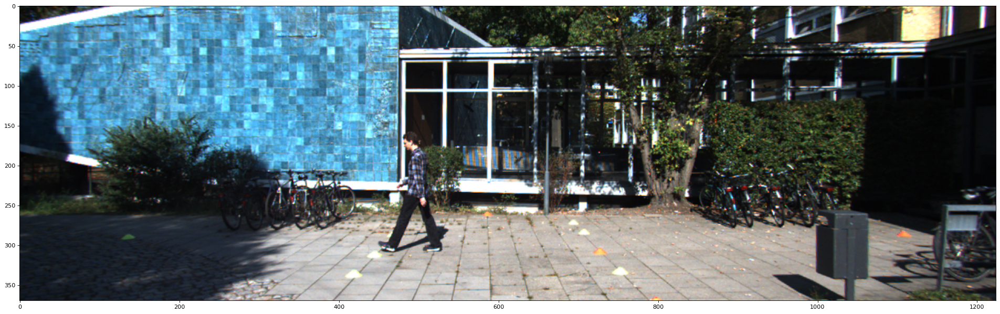

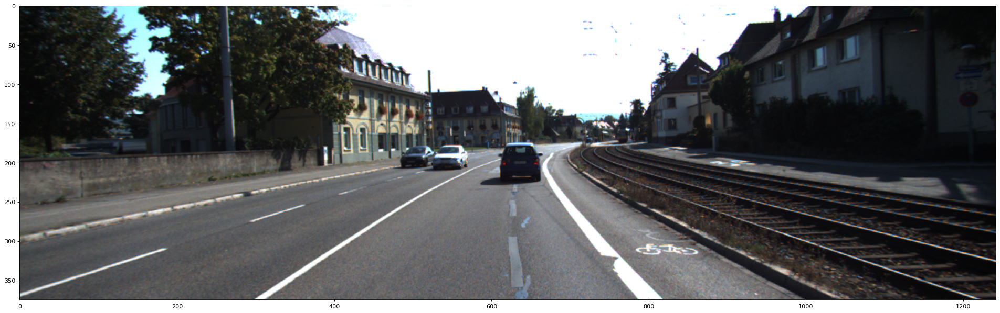

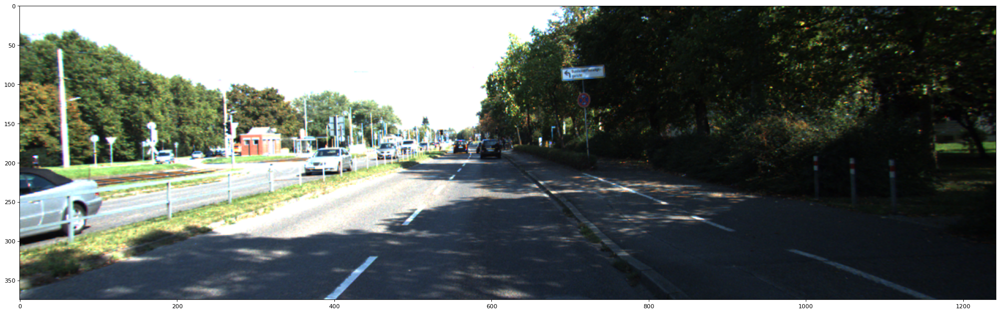

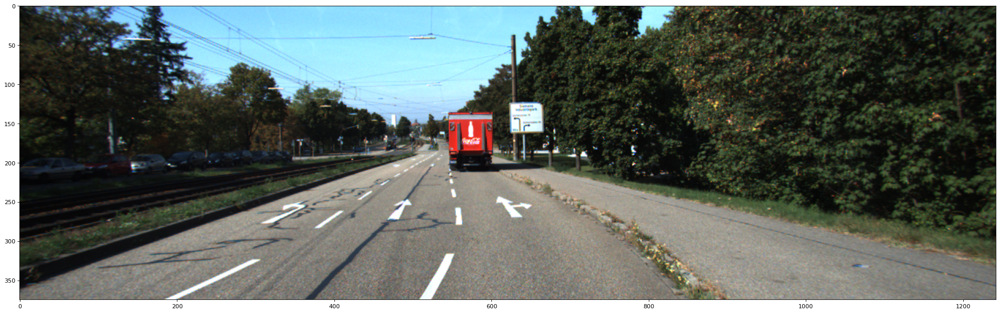

In [5]:
images = []
for index in index_list:
    visualize_image(index)
    images.append(mpimg.imread(f"image_{index}.png"))
    
for image in images:
    plt.figure(figsize=(30, 30), dpi=80)
    plt.imshow(image)
    plt.show()

Saving Image: image_box_6747.png
Saving Image: image_box_6029.png
Saving Image: image_box_3509.png
Saving Image: image_box_1658.png
Saving Image: image_box_5832.png


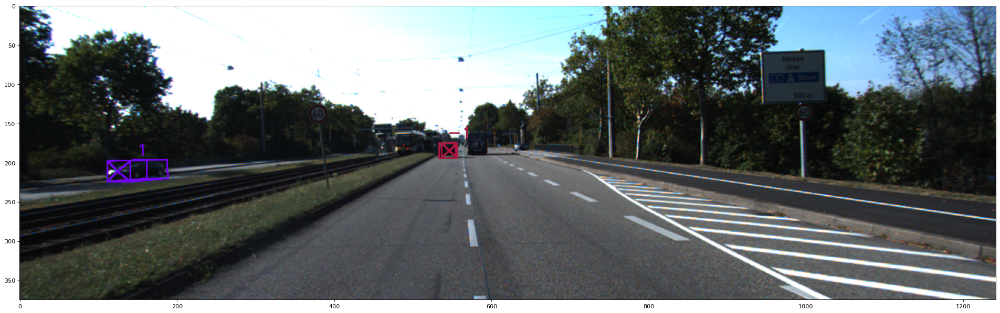

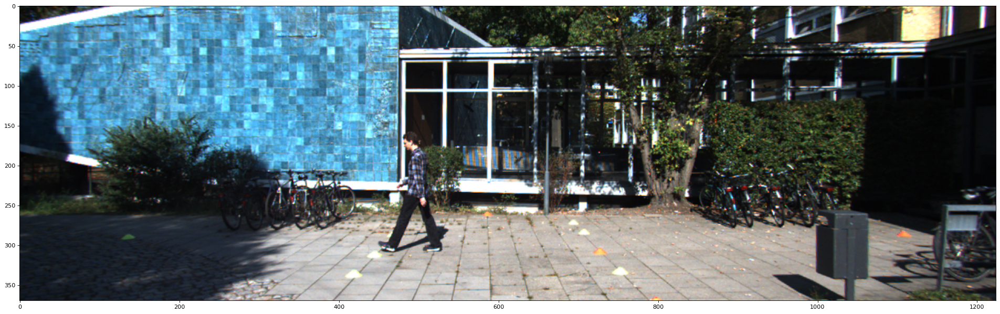

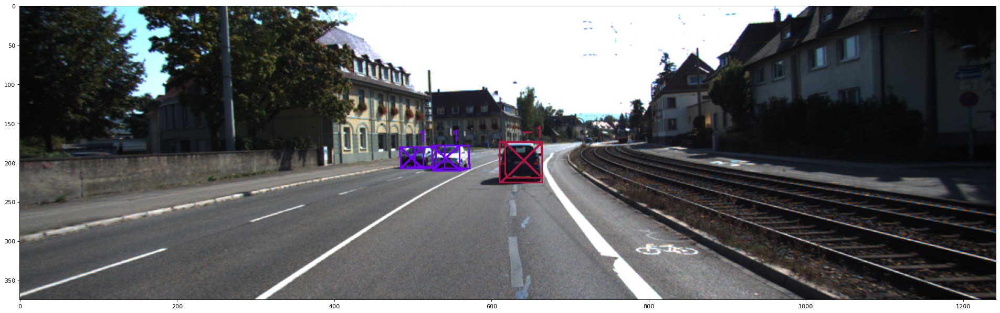

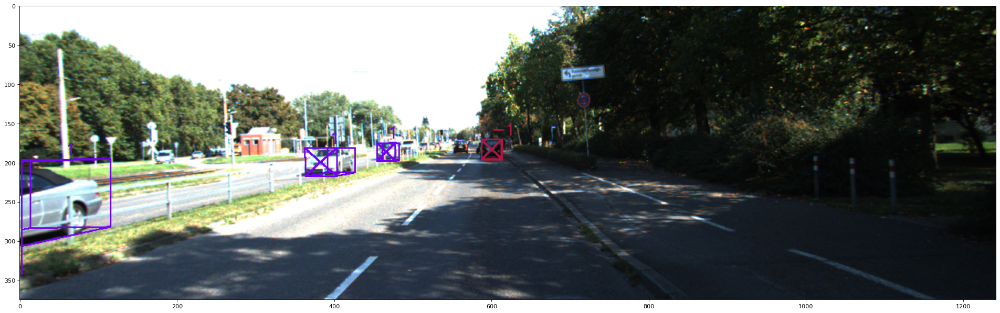

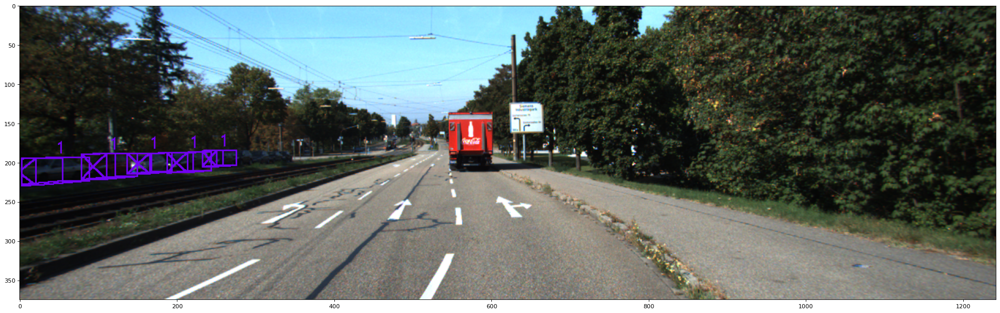

In [6]:
images = []
for index in index_list:
    visualize_image_box(index)
    images.append(mpimg.imread(f"image_box_{index}.png"))
    
for image in images:
    plt.figure(figsize=(30, 30), dpi=80)
    plt.imshow(image)
    plt.show()

Saving Image: image_full_6747.png
Saving Image: image_full_6029.png
Saving Image: image_full_3509.png
Saving Image: image_full_1658.png
Saving Image: image_full_5832.png


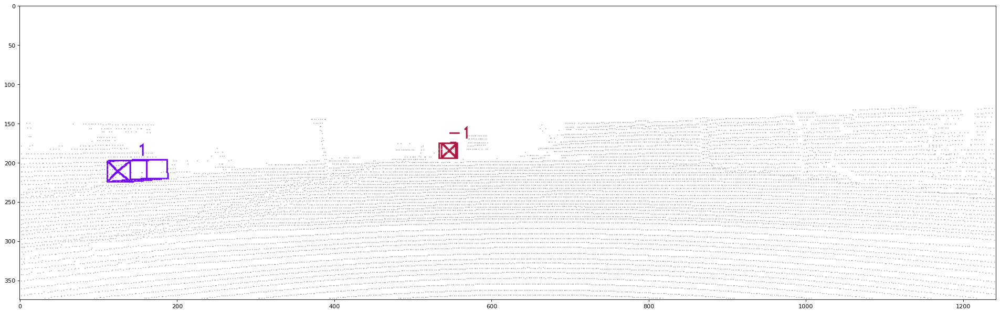

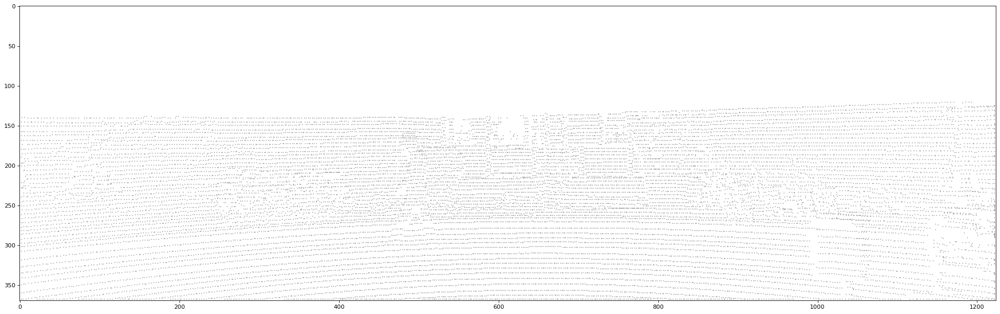

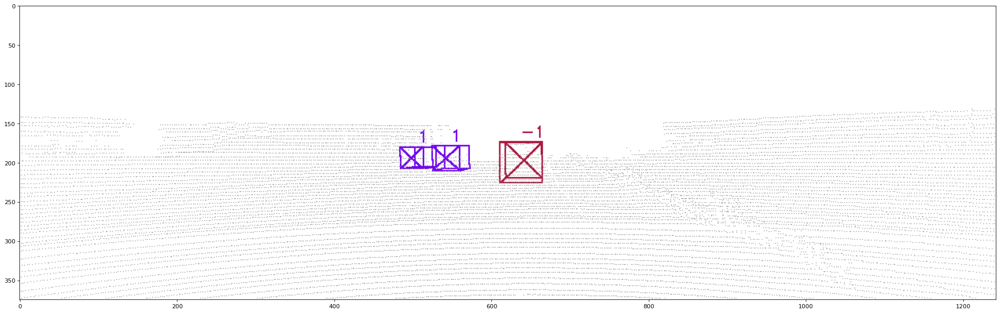

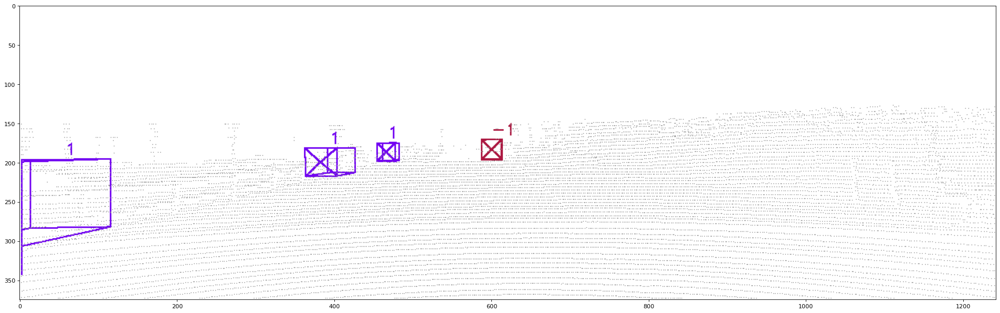

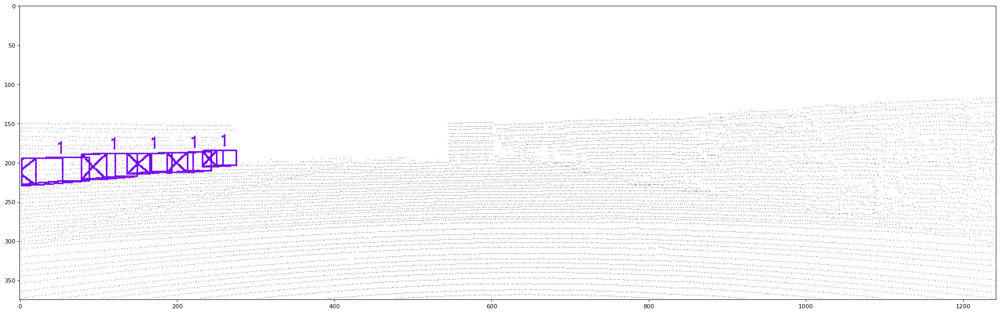

In [7]:
images = []
for index in index_list:
    visualize(index)
    images.append(mpimg.imread(f"image_full_{index}.png"))
    
for image in images:
    plt.figure(figsize=(30, 30), dpi=80)
    plt.imshow(image)
    plt.show()